# Customer Segmentation with K-Means

## Project Overview
This project identifies 3 main customer segments with K-Means clustering: Low-Value Low-Frequency, High-Value Low-Frequency, and Low-Value High-Frequency Users. Furthermore, sub-segmentation and prioritization of the clusters are based on recency. 

The variable selection process for clustering is done by both PCA and business intuition. The clusters generated are evaluated with Silhouette Coefficient and statistical analysis. In following up with this, recommendations for marketing reactivation is provided based on recency and characteristics of different segments.

## Problem Statement
A food delivery company X would like to find pattenrs and insights in the user data and intend to create customized marketing campaign to reactivate based on a user's status. Find insights in the data and try to cluster the users based on their characteristics and behaviours. 

## Table of Content
**Click the link below to be quickly directed to different section:**
### - [1. Data Understanding & Quality Check](#data_understand)
### - [2. Data Cleaning & Pre-processing](#clean)
### - [3. Feature Engineering and Missing Value Imputation](#feature)
### - [4. Exploratory Data Analysis](#eda)
### - [5. Data Transformation for Clustering](#transform)
### - [6. Variable Reduction (PCA)](#pca)
### - [7. K-Means Clustering](#kmeans)
### - [8. Evaluate and Validate the Clusters](#evaluate)
### - [9. EDA with the generated Clusters](#eda_cluster)

In [9]:
import pandas as pd
import numpy as np
import re
from datetime import datetime, date, time
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px
import plotly.figure_factory as ff
import seaborn as sns
import matplotlib.pyplot as plt

from scipy import stats
from sklearn.decomposition import PCA
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import FunctionTransformer
from imblearn.pipeline import Pipeline

# Display all columns when printing a dataframe
pd.set_option('display.max_columns', None)

In [10]:
df = pd.read_csv('dataset.csv')

In [12]:
df.head(10)

,REGISTRATION_DATE,REGISTRATION_COUNTRY,PURCHASE_COUNT,PURCHASE_COUNT_DELIVERY,PURCHASE_COUNT_TAKEAWAY,FIRST_PURCHASE_DAY,LAST_PURCHASE_DAY,USER_ID,BREAKFAST_PURCHASES,LUNCH_PURCHASES,EVENING_PURCHASES,DINNER_PURCHASES,LATE_NIGHT_PURCHASES,TOTAL_PURCHASES_EUR,DISTINCT_PURCHASE_VENUE_COUNT,MIN_PURCHASE_VALUE_EUR,MAX_PURCHASE_VALUE_EUR,AVG_PURCHASE_VALUE_EUR,PREFERRED_DEVICE,IOS_PURCHASES,WEB_PURCHASES,ANDROID_PURCHASES,PREFERRED_RESTAURANT_TYPES,USER_HAS_VALID_PAYMENT_METHOD,MOST_COMMON_HOUR_OF_THE_DAY_TO_PURCHASE,MOST_COMMON_WEEKDAY_TO_PURCHASE,AVG_DAYS_BETWEEN_PURCHASES,MEDIAN_DAYS_BETWEEN_PURCHASES,AVERAGE_DELIVERY_DISTANCE_KMS,PURCHASE_COUNT_BY_STORE_TYPE
0,2019-09-01 00:00:00.000,DNK,0,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ios,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,"{\n ""General merchandise"": 0,\n ""Grocery"": 0..."
1,2019-09-01 00:00:00.000,FIN,1,1.0,0.0,2020-09-02 00:00:00.000,2020-09-02 00:00:00.000,2,0.0,1.0,0.0,0.0,0.0,38.456,1.0,38.532,38.608,38.456,android,0.0,0.0,1.0,NaN,False,23.0,2.0,NaN,NaN,6.853,"{\n ""General merchandise"": 0,\n ""Grocery"": 0..."
2,2019-09-01 00:00:00.000,DNK,19,19.0,0.0,2019-12-10 00:00:00.000,2020-05-25 00:00:00.000,3,0.0,4.0,1.0,14.0,0.0,631.488,9.0,20.280,43.688,33.396,android,0.0,19.0,0.0,NaN,True,21.0,2.0,9.0,3.0,6.559,"{\n ""General merchandise"": 1,\n ""Grocery"": 9..."
3,2019-09-01 00:00:00.000,FIN,0,NaN,NaN,NaN,NaN,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,android,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,"{\n ""General merchandise"": 0,\n ""Grocery"": 0..."
4,2019-09-01 00:00:00.000,GRC,0,NaN,NaN,NaN,NaN,5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,android,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,"{\n ""General merchandise"": 0,\n ""Grocery"": 0..."
5,2019-09-01 00:00:00.000,FIN,0,NaN,NaN,NaN,NaN,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,android,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,"{\n ""General merchandise"": 0,\n ""Grocery"": 0..."
6,2019-09-01 00:00:00.000,DNK,0,NaN,NaN,NaN,NaN,7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ios,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,"{\n ""General merchandise"": 0,\n ""Grocery"": 0..."
7,2019-09-01 00:00:00.000,FIN,1,1.0,0.0,2020-10-14 00:00:00.000,2020-10-14 00:00:00.000,8,0.0,0.0,1.0,0.0,0.0,19.228,1.0,19.266,19.304,19.228,android,0.0,0.0,1.0,NaN,True,5.0,1.0,NaN,NaN,1.251,"{\n ""General merchandise"": 0,\n ""Grocery"": 0..."
8,2019-09-01 00:00:00.000,FIN,0,NaN,NaN,NaN,NaN,9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,android,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,"{\n ""General merchandise"": 0,\n ""Grocery"": 0..."
9,2019-09-01 00:00:00.000,FIN,0,NaN,NaN,NaN,NaN,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,android,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,"{\n ""General merchandise"": 0,\n ""Grocery"": 0..."


In [13]:
df.columns

Index(['REGISTRATION_DATE', 'REGISTRATION_COUNTRY', 'PURCHASE_COUNT',
       'PURCHASE_COUNT_DELIVERY', 'PURCHASE_COUNT_TAKEAWAY',
       'FIRST_PURCHASE_DAY', 'LAST_PURCHASE_DAY', 'USER_ID',
       'BREAKFAST_PURCHASES', 'LUNCH_PURCHASES', 'EVENING_PURCHASES',
       'DINNER_PURCHASES', 'LATE_NIGHT_PURCHASES', 'TOTAL_PURCHASES_EUR',
       'DISTINCT_PURCHASE_VENUE_COUNT', 'MIN_PURCHASE_VALUE_EUR',
       'MAX_PURCHASE_VALUE_EUR', 'AVG_PURCHASE_VALUE_EUR', 'PREFERRED_DEVICE',
       'IOS_PURCHASES', 'WEB_PURCHASES', 'ANDROID_PURCHASES',
       'PREFERRED_RESTAURANT_TYPES', 'USER_HAS_VALID_PAYMENT_METHOD',
       'MOST_COMMON_HOUR_OF_THE_DAY_TO_PURCHASE',
       'MOST_COMMON_WEEKDAY_TO_PURCHASE', 'AVG_DAYS_BETWEEN_PURCHASES',
       'MEDIAN_DAYS_BETWEEN_PURCHASES', 'AVERAGE_DELIVERY_DISTANCE_KMS',
       'PURCHASE_COUNT_BY_STORE_TYPE'],
      dtype='object')

# 1. Data Understanding & Quality Check<a id='data_understand'></a>
In this section, I will have a glimpse of the data its quality (missing values, duplication,  etc.)

In [14]:
#Convert the column names to lower cases
columns = [x.lower() for x in df.columns.to_list()]
df.columns = columns

## 1-1. Check the share of the missing values (null rows) of each column
- Based on the below output, around 45% of purchase count related data is null. This means there are users that never made any orders.

In [15]:
# Check share of the null rows of each column
df.isnull().sum()/df.shape[0]

registration_date                          0.000000
registration_country                       0.000000
purchase_count                             0.000000
purchase_count_delivery                    0.452850
purchase_count_takeaway                    0.452850
first_purchase_day                         0.455761
last_purchase_day                          0.452895
user_id                                    0.000000
breakfast_purchases                        0.452850
lunch_purchases                            0.452850
evening_purchases                          0.452850
dinner_purchases                           0.452850
late_night_purchases                       0.452850
total_purchases_eur                        0.452850
distinct_purchase_venue_count              0.452850
min_purchase_value_eur                     0.452850
max_purchase_value_eur                     0.452850
avg_purchase_value_eur                     0.452850
preferred_device                           0.003321
ios_purchase

## 1-2. Check the number of unique values for each column
- Based on the output below:
1. Without further validation, we can guage that there is no duplicate user_id. The dataframe has 21983 rows while the count of unique `user_id` is also 21983. I will double check this again later.
2. We have high cardinality features such as Country.

In [16]:
# Check the shape of the table
print(df.shape)

(21983, 30)


In [17]:
for i in list(df.columns):
    print(f'Unique {i}: {df[i].nunique()}')

Unique registration_date: 30
Unique registration_country: 59
Unique purchase_count: 107
Unique purchase_count_delivery: 106
Unique purchase_count_takeaway: 26
Unique first_purchase_day: 426
Unique last_purchase_day: 427
Unique user_id: 21983
Unique breakfast_purchases: 22
Unique lunch_purchases: 67
Unique evening_purchases: 31
Unique dinner_purchases: 57
Unique late_night_purchases: 1
Unique total_purchases_eur: 1088
Unique distinct_purchase_venue_count: 40
Unique min_purchase_value_eur: 153
Unique max_purchase_value_eur: 224
Unique avg_purchase_value_eur: 168
Unique preferred_device: 3
Unique ios_purchases: 79
Unique web_purchases: 65
Unique android_purchases: 76
Unique preferred_restaurant_types: 247
Unique user_has_valid_payment_method: 2
Unique most_common_hour_of_the_day_to_purchase: 24
Unique most_common_weekday_to_purchase: 7
Unique avg_days_between_purchases: 392
Unique median_days_between_purchases: 392
Unique average_delivery_distance_kms: 7577
Unique purchase_count_by_store_

## 1-3. Check duplicate rows based on all columns, and user_id
- As a result, no duplicate rows or duplicate user id found

In [18]:
# check number of duplicates
df.duplicated().any().sum()

0

In [19]:
df[df.duplicated('user_id')].sort_values('user_id', ascending = True)

,registration_date,registration_country,purchase_count,purchase_count_delivery,purchase_count_takeaway,first_purchase_day,last_purchase_day,user_id,breakfast_purchases,lunch_purchases,evening_purchases,dinner_purchases,late_night_purchases,total_purchases_eur,distinct_purchase_venue_count,min_purchase_value_eur,max_purchase_value_eur,avg_purchase_value_eur,preferred_device,ios_purchases,web_purchases,android_purchases,preferred_restaurant_types,user_has_valid_payment_method,most_common_hour_of_the_day_to_purchase,most_common_weekday_to_purchase,avg_days_between_purchases,median_days_between_purchases,average_delivery_distance_kms,purchase_count_by_store_type


# 2. Data Cleaning & Pre-processing<a id='clean'></a>

## 2-1. Clean up `purchase_count_by_store_type` column
- Inside the `purchase_count_by_store_type` column, extract the 5 categories (general merchandise, grocery, pet supplies, restaurant, retail_store) as separate columns
- Before procedding, check if all rows in `purchase_count_by_store_type` more or less have the same lengths; the number of the categories may not be fixed (perhaps in some rows there are more than 5 categories)
- Find the row with maximum character length and check if it still has only 5 categories


In [20]:
# Check the length of all rows
df['cnt_string'] = df['purchase_count_by_store_type'].str.len()
df['cnt_string']

0        107
1        107
2        107
3        107
4        107
        ... 
21978    107
21979    107
21980    107
21981    107
21982    107
Name: cnt_string, Length: 21983, dtype: int64

In [21]:
# Find the row with maximum character length and check if it still has only 5 categories
print(df[df['cnt_string'] == 111]['purchase_count_by_store_type'].iloc[1])

{
  "General merchandise": 0,
  "Grocery": 102,
  "Pet supplies": 1,
  "Restaurant": 102,
  "Retail store": 0
}


It seems like these are the only 5 categories in this column, we can assume and proceed with the data cleaning

In [22]:
# drop the additional data quality check column
df = df.drop(['cnt_string'], axis = 1)

### Steps to clean up `purchase_count_by_store_type`
- Create a list of all 5 store types
- Split the column and expand them, remove the unnecessary charaters in the beginning and the end.
- Iterate through the above generated columns in df to keep only the last character of each string (the number of purchases for each store type in thes context). For example, `"General merchandise": 0` becomes `0`, `"General merchandise": 1` becomes `1`. 
- Convert the above extracted string to a numeric value.
- Perform normal string actions on Pandas Series by including `.str` after the Series.
- Drop the original `purchase_count_by_store_type` column from `df`

In [23]:
# Get a list of the store types
store_type_list = ["general_merchandise","grocery","pet_supplies",
 "restaurant","retail_store"]

# Split the column and expand them while removing the unnecessary charaters in the beginning and at the end,
df[store_type_list] = df['purchase_count_by_store_type'].str[3:-2].str.split(',\n', expand=True)

df[store_type_list].head()

,general_merchandise,grocery,pet_supplies,restaurant,retail_store
0,"""General merchandise"": 0","""Grocery"": 0","""Pet supplies"": 0","""Restaurant"": 0","""Retail store"": 0"
1,"""General merchandise"": 0","""Grocery"": 0","""Pet supplies"": 0","""Restaurant"": 1","""Retail store"": 0"
2,"""General merchandise"": 1","""Grocery"": 9","""Pet supplies"": 0","""Restaurant"": 9","""Retail store"": 0"
3,"""General merchandise"": 0","""Grocery"": 0","""Pet supplies"": 0","""Restaurant"": 0","""Retail store"": 0"
4,"""General merchandise"": 0","""Grocery"": 0","""Pet supplies"": 0","""Restaurant"": 0","""Retail store"": 0"


In [24]:
for column in store_type_list:
    # set each value to be the last character of the string
    df[column] = df[column].apply(lambda x: x[-1])
    
    # convert column from string to numeric
    df[column] = df[column].astype(int)

df[store_type_list].head()

,general_merchandise,grocery,pet_supplies,restaurant,retail_store
0,0,0,0,0,0
1,0,0,0,1,0
2,1,9,0,9,0
3,0,0,0,0,0
4,0,0,0,0,0


In [25]:
# drop the original categories column from `df`
df = df.drop(['purchase_count_by_store_type'], axis = 1)

## 2-2. Convert the date column to datetime
There is no time (hour, minute) information in the timestamp columns, all rows have 00:00:00, so we can simply convert them into `%Y-%m-%d` format


In [26]:
for col in ['first_purchase_day', 'last_purchase_day','registration_date']:
    df[col] = pd.to_datetime( df[col], format='%Y-%m-%d')

## 2-3. Clean up `preferred_restaurant_types`
- In this column, there is a **non-fixed** number of categories in the array for each row, as a user can have multiple preferred restaurant types. 
- One user can have 7 restaurant types preferred in the dataset or none:

In [27]:

df['cnt_string'] = df['preferred_restaurant_types'].str.len()
print(df[df['cnt_string'] == df['cnt_string'].max()]['preferred_restaurant_types'].iloc[0])

[
  "american",
  "japanese",
  "italian",
  "mexican",
  "greek",
  "indian",
  "thai"
]


### Steps to clean `preferred_restaurant_types`
- Create a separate dataframe `restaurant` that is from the `preferred_restaurant_types` column
- Clean the `restaurant` data and extract a list of unique values of the restaurant type
- Create **one hot ending** columns in df that identifies whether the type of restaurant is preferred by the user. For example, for the "American" column, if it is `1` , then user prefers it, if it is `0` then the user doesn't prefer the restaurant type

In [28]:
# Single out the the column, filter for non-null values
restaurant = df[df['preferred_restaurant_types'].notnull()]['preferred_restaurant_types'].reset_index()

# Clean up the column with the string replace function
restaurant['preferred_restaurant_types'] = restaurant['preferred_restaurant_types'].str.replace('\n ','').str.replace('\n','').str.replace('[','', regex=True).str.replace(']','', regex=True).str.replace('"','').str.replace(' ','')

In [29]:
# Get a list of unique restaurant type list
restaurant_types_list = restaurant['preferred_restaurant_types'].str.split(',', expand=False).explode().unique().tolist() 

print(restaurant_types_list)

['american', 'japanese', 'italian', 'middleeastern', 'mexican', 'indian', 'vietnamese', 'korean', 'nepalese', 'chinese', 'hawaiian', 'thai', 'greek', 'spanish']


In [30]:
# Convert the column to string
df['preferred_restaurant_types'] = df['preferred_restaurant_types'].astype(str)

for r in restaurant_types_list:
    df[r] = "" # generate a new column
    df[r] = np.where(df['preferred_restaurant_types'].str.contains(r, re.IGNORECASE), 1, 0)
    #df.loc[df['preferred_restaurant_types'].str.contains(r, re.IGNORECASE).replace(np.nan, False),r] = 1


In [31]:
# drop the original column and the column to count the length from `df`
df = df.drop(['preferred_restaurant_types', 'cnt_string'], axis = 1)

# 3. Feature Engineering & Missing Value Imputation<a id='feature'></a>
- 3-1. Create time related columns
- 3-2. Create a "customer value" column
- 3-3. Add a label to indicate whether the customer's made a purchase or not
- 3-4. Add distinct prefered restaurant type per user

## 3-1. Create Time related columns such
- 1. `days_since_last_order`: I would like to have data that indicates the "Recency" factor.
- 2. `days_since_joined`: Number of days between registration till the last_purchase_day. With this column, we can have a rough idea of how long has it been since the user joined. 
- 3. `days_to_first_order` (user onboarding time): Number of days from registration till the first order. This can be useful to understand how fast a user onboards with the product.

In [32]:
df['last_purchase_day'].max()

Timestamp('2020-10-31 00:00:00')

In [33]:
# Create a column for "today" - last date in the data set, which is 2020-10-31
df['today'] = pd.to_datetime( '2020-10-31', format='%Y-%m-%d')

In [34]:
# Calculate days since a user's last purchase timestamp
df['days_since_last_order']= df['today'] - df['last_purchase_day']

# Calculate days since a user joined
df['days_since_joined']= df['today'] - df['registration_date']

# Calculate user onboarding time
df['days_to_first_order']= df['first_purchase_day'] - df['registration_date']

In [35]:
# Convert them to integers:
for time_column in ['days_since_last_order', 'days_since_joined', 'days_to_first_order']:
    df[time_column] = pd.to_numeric(df[time_column].dt.days, downcast='integer')
    #df[time_column] = df[time_column].astype(int)


In [36]:
df[['days_since_last_order', 'days_since_joined', 'days_to_first_order']].head()

,days_since_last_order,days_since_joined,days_to_first_order
0,NaN,426,NaN
1,59.0,426,367.0
2,159.0,426,100.0
3,NaN,426,NaN
4,NaN,426,NaN


In [37]:
df = df.drop(['today'], axis = 1)

## 3-2. Create a "customer value" column
- In food delivery services, the Average order value and the frequeuncy of a customer's ordder behaviour is important in calculating a customer's life time value and profitability in general. Thus, I'm creating this value for later exploratory data analysis purposes

In [38]:
df['customer_value'] = df['purchase_count'] * df['avg_purchase_value_eur']

## 3-3. Add a label to indicate whether the customer's made a purchase or not

In [39]:
df['paid_customer'] = np.where(df['purchase_count']==0, 'non-paid', 'paid')


In [40]:
df.head()

,registration_date,registration_country,purchase_count,purchase_count_delivery,purchase_count_takeaway,first_purchase_day,last_purchase_day,user_id,breakfast_purchases,lunch_purchases,evening_purchases,dinner_purchases,late_night_purchases,total_purchases_eur,distinct_purchase_venue_count,min_purchase_value_eur,max_purchase_value_eur,avg_purchase_value_eur,preferred_device,ios_purchases,web_purchases,android_purchases,user_has_valid_payment_method,most_common_hour_of_the_day_to_purchase,most_common_weekday_to_purchase,avg_days_between_purchases,median_days_between_purchases,average_delivery_distance_kms,general_merchandise,grocery,pet_supplies,restaurant,retail_store,american,japanese,italian,middleeastern,mexican,indian,vietnamese,korean,nepalese,chinese,hawaiian,thai,greek,spanish,days_since_last_order,days_since_joined,days_to_first_order,customer_value,paid_customer
0,2019-09-01,DNK,0,NaN,NaN,NaT,NaT,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ios,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,426,NaN,NaN,non-paid
1,2019-09-01,FIN,1,1.0,0.0,2020-09-02,2020-09-02,2,0.0,1.0,0.0,0.0,0.0,38.456,1.0,38.532,38.608,38.456,android,0.0,0.0,1.0,False,23.0,2.0,NaN,NaN,6.853,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,59.0,426,367.0,38.456,paid
2,2019-09-01,DNK,19,19.0,0.0,2019-12-10,2020-05-25,3,0.0,4.0,1.0,14.0,0.0,631.488,9.0,20.280,43.688,33.396,android,0.0,19.0,0.0,True,21.0,2.0,9.0,3.0,6.559,1,9,0,9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,159.0,426,100.0,634.524,paid
3,2019-09-01,FIN,0,NaN,NaN,NaT,NaT,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,android,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,426,NaN,NaN,non-paid
4,2019-09-01,GRC,0,NaN,NaN,NaT,NaT,5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,android,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,426,NaN,NaN,non-paid


## 3-4. Add distinct preferred restaurant types

In [41]:
df['number_of_preferred_rest_type']= df['american']+ df['japanese']+df['italian']+df['middleeastern']+df['mexican']+df['indian']+df['vietnamese']+df['korean']+df['nepalese']+df['chinese']+df['hawaiian']+df['thai']+df['greek']+df['spanish']

## 3-5. Add a column to bin the avg/median days between orders
Runnning this after the missing value imputation


In [42]:
def days_bin(x):
    """Function: Define ranges of values for percentage differenence between the predicted and actual price.
    """
    if x =='NaN' or x is None :
        return x
    elif x <=15:
        return "0-15 days"
    elif x > 15 and x <= 30:
        return "15-30 days"
    elif x > 30 and x <= 60:
        return "30-60 days"
    elif x > 60 and x <= 90:
        return "60-90 days"
    elif x > 90 and x <= 120:
        return "90-12 days"
    else:
        return '>120 days'
    # Add elif statements....


## 3-6. Define Numerical and categorical columns
Based on the above, define the numerical and categorical columns for the analysis

In [43]:
date_cols = ['registration_date', 'last_purchase_day','first_purchase_day' ]
cat_cols = ['registration_country', 'preferred_device','user_has_valid_payment_method',
           'most_common_weekday_to_purchase','most_common_hour_of_the_day_to_purchase', 'paid_customer']
num_cols= [col for col in df.columns.tolist() if col not in (date_cols+cat_cols+restaurant_types_list+['user_id'])]
num_cols = num_cols+['most_common_weekday_to_purchase','most_common_hour_of_the_day_to_purchase']

## 3-7. Missing value Imputation
| Columns | Imputation methods |
| --- | --- |
|Count of purchase | 0 |
|Sum of purchase value | 0 |
|Avg/median days between purchase |for users with only 1 purchase, use'days_since_last_order'. |
|Most common weekday |--|
|Delivary Distance |--|
|Categorical Values |NaN String|

In [49]:
purchase_and_value_cols = [k for k in num_cols if 'purchase' in k or 'value' in k]

In [50]:
df[purchase_and_value_cols].fillna(0, inplace = True)

In [51]:
df[cat_cols] = df[cat_cols].replace(np.nan, 'NaN')

In [52]:
df['median_days_between_purchases'] = np.where(df['purchase_count'] == 1, df['days_since_last_order'], df['median_days_between_purchases'])
df['avg_days_between_purchases'] = np.where(df['purchase_count'] == 1, df['days_since_last_order'], df['avg_days_between_purchases'])

In [53]:
df[['purchase_count', 'median_days_between_purchases','avg_days_between_purchases', 'days_since_last_order']].head()

,purchase_count,median_days_between_purchases,avg_days_between_purchases,days_since_last_order
0,0,NaN,NaN,NaN
1,1,59.0,59.0,59.0
2,19,3.0,9.0,159.0
3,0,NaN,NaN,NaN
4,0,NaN,NaN,NaN


# 4. Exploratory Data Aanalysis<a id='eda'></a>

## 4-1. Visualize  purchase value/count/#users  by Categorical columns

In [54]:
def aggregate_data(df = df, col= ['paid_customer', 'days bin'], stacked = False, val = 'user_id', agg_method = 'sum'):

    if agg_method =='mean':
        df_group =df.groupby(col)[val].mean().reset_index()
       
    elif agg_method =='count':
        if stacked == True:
            df_group = df.groupby(col)[val].size().transform(lambda x: x/x.sum()).reset_index().rename(columns={'user_id':'# of Users'})
        else:
            df_group =df.groupby(col)[val].size().reset_index().rename(columns={'user_id':'# of Users'})
            
    elif agg_method == 'sum':
        if stacked == True:
            df_group = df.groupby(col)[val].sum().groupby(level = 0).transform(lambda x: x/x.sum()).reset_index()
        else:
            df_group =df.groupby(col)[val].sum().reset_index()
    else:
        df_group =df.groupby(col)[val].sum().reset_index() #default agg method: sum
    return df_group

In [55]:
def plot_bar_chart(df = df, col ='registration_country', stacked = False, y = 'user_id',title = ''):
    """Plot bar chart with one dimension"""
        
    fig = px.bar(df, x=col, y=y, height=400, width=600, template = "plotly_white",
         color_discrete_sequence=px.colors.qualitative.Set2, title = '<b>'+ title + '<br>')
    fig.update_layout(title=dict(font=dict(size=20)),
        xaxis_title=col,
        yaxis_title="",font=dict(family="Avenir" ))
    fig.update_xaxes(ticks="outside",type='category',
                     tickfont=dict(size=15))
    fig.show()

In [41]:
def plot_multi_bar_chart(df = df, cat_columns =cat_cols, stacked = False, y = 'user_id', title = ''):
    """
    Iterate through the given list of columns and group the dataframe by each of them and plot multiple barchart and
    show them in the cell output.
    """
     
    for col in cat_columns:
        fig = px.bar(df, x=col, y=y,
             height=400, width=600, template = "plotly_white", color_discrete_sequence=px.colors.qualitative.Set2,
             title = title)
        fig.update_layout(title=dict(font=dict(size=18)),xaxis_title=col,
            xaxis={'categoryorder':'total descending'},yaxis_title=y,
            font=dict(family="Avenir" ))
        fig.update_xaxes(ticks="outside",type='category',
                         tickfont=dict(size=12))
        fig.show()
        

### 4-1-1. Filter out paid and non-paid customers
- We can see that 45% of the users hasn't made any purchase
- non-paid users don't have any purchase count and value data and has little insights. They also behave differently in terms of payment method etc.
- I would like to filter out the non-paid users and focus on the paid users first

In [56]:
dfp = df[df['purchase_count'] != 0]
dfn = df[df['purchase_count'] == 0]

### 4-1-2. Filter out users without days_between orders data
- These are the users with more than 1 order.

In [57]:
dfpx = dfp[dfp['purchase_count']>1]
dfpx = dfpx[dfpx['avg_days_between_purchases'].notnull()]

### 4-1-4. Plot Histogram for Days between orders metrics

In [62]:
# Plot only histogram and curve
x1 = dfpx ['avg_days_between_purchases']
x2 = dfpx ['median_days_between_purchases']

# Group data together
hist_data = [x2,x1]

group_labels = ['avg_days_between_purchases', 'median_days_between_purchases']
colors = ['#A56CC1', '#A6ACEC']

# Create distplot with curve_type set to 'normal'
fig = ff.create_distplot(hist_data, group_labels, #colors=colors,
                         bin_size=.4, show_rug=False)

# Add title
fig.update_layout(title_text='<b>Hist and Curve Plot<br>',height = 400, width = 600,title=dict(font=dict(size=22)), 
                                                               font=dict(family="Avenir", size = 16), template = 'plotly_white')
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="right",
    x=0.99, bgcolor = 'rgba(0,0,0,0)'
))
fig.show()


In [63]:
fig = go.Figure()
fig = go.Figure(data=[go.Box(y=dfpx,name = 'avg_days_between_purchases'
              )])
fig.add_trace(go.Box(y=dfpx, name = 'median_days_between_purchases',
                marker_color = 'lightseagreen'))
# Add title
fig.update_layout(title_text='<b>BoxPlot - Days Between Purchases (User Level) <br>',
                  height = 500, width = 1000,title=dict(font=dict(size=22)), 
                                                               font=dict(family="Avenir", size = 16), template = 'plotly_white')
# fig.update_layout(legend=dict(
#     yanchor="top",
#     y=0.99,
#     xanchor="right",
#     x=0.99, bgcolor = 'rgba(0,0,0,0)'
# ))
fig.show()

### 4-1-4. Explore Days bin and other summary statistics

In [64]:
dfpx['days bin'] = dfpx['median_days_between_purchases'].apply(days_bin)

In [68]:
dfpx_agg = aggregate_data(df = dfpx, col= ['days bin'], stacked = False, val = 'user_id', agg_method = 'count')
plot_bar_chart(df = dfpx_agg, col ='days bin', stacked = False, y = '# of Users',
                  title = '# of Users by Median Days between orders')

In [69]:
purchase_agg = aggregate_data(df = dfpx, col= ['days bin'], stacked = False, val = 'purchase_count', 
                              agg_method = 'sum')

In [72]:
plot_bar_chart(df = purchase_agg, col ='days bin', stacked = False, y = 'purchase_count',
                  title = '# of Orders by Median Days between orders')

## 4-2. Plot Correlation Heatmap

In [73]:
# Remove some columns so it looks nicer in the visuals
num_cols_reduced = [i for i in num_cols if i not in ['late_night_purchases', 'general_merchandise','grocery','pet_supplies','restaurant','retail_store','avg_days_between_purchases', 'customer_value', 'number_of_preferred_rest_type', 'days_since_joined', 'days_to_first_order', 'days_since_last_order', 'purchase_count_takeaway', 'purchase_count_delivery', 'android_purchases', 'average_delivery_distance_kms', 'total_purchases_eur']]

In [74]:
df_numeric = dfp[ num_cols_reduced ]

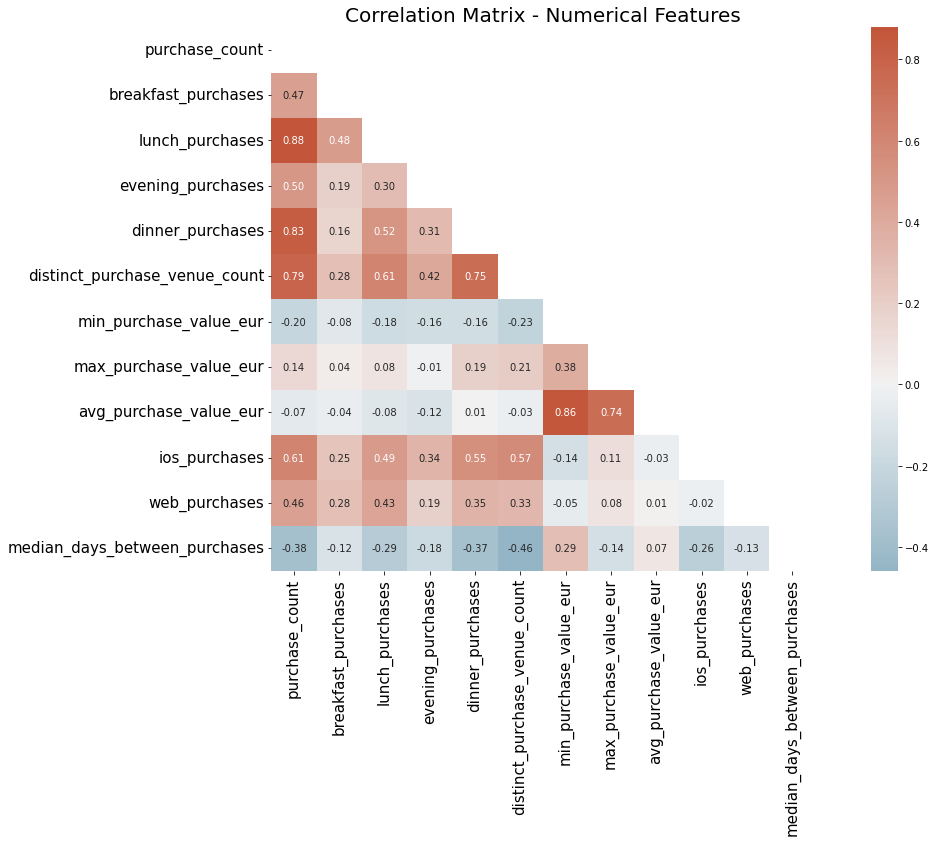

In [75]:

corr =  df_numeric.corr()

# Create a mask
mask = np.triu(np.ones_like(corr, dtype=bool))

# Create a custom divergin palette
cmap = sns.diverging_palette(230, 20, n=256, as_cmap=True)
f, ax = plt.subplots(figsize=(20, 10))
#plt.figure(figsize=(30, 20))
sns.heatmap(corr, mask=mask, center=0, annot=True,annot_kws={ 'size':10},
            fmt='.2f', square=True, cmap=cmap)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=15)
ax.set_xticklabels(ax.get_xticklabels(), fontsize=15)
plt.title('Correlation Matrix - Numerical Features', fontsize = 20)

plt.show();
#plt.savefig('corr.png')

## 4-3. EDA: Group by each categorical volumn, check total purchase count, avg. values and count of users
One of the main goal is to reactivate inactive customers and gain more repeated purchases. Let's deep dive into the days betweeen purhases


### 4-3-1. Avg. Purchase Value by Days Bin

In [84]:
dfp['days bin'] = dfp['median_days_between_purchases'].apply(days_bin)

In [85]:
dfp_agg = aggregate_data(df = dfp, col= ['days bin'], stacked = False, val = 'avg_purchase_value_eur', agg_method = 'mean')
plot_bar_chart(df = dfp_agg, col ='days bin', stacked = False, y = 'avg_purchase_value_eur',
                  title = 'Avg. Order Value by Days Bin')

### 4-3-2.  purchasec count by each dimension
Quick Insights:
- Top 3 countries:FIN, DNK, GRC, the rest has very little volume
- Device purchase: iOS >andriod > web
- Most common weekday to purchase: 4, 7, 2
- Most common hour: 23, 3, 1

In [81]:
for i in cat_cols:
    agg = aggregate_data(df = dfp, col= i, stacked = False, val = 'purchase_count', agg_method = 'sum')
    plot_bar_chart(df = agg, col =i, stacked = False, y = 'purchase_count',
                  title = f'# of Orders by {i}')

### 4-3-3. By Mean of the Avg. Purchase Value
Quick Insights:
- Top 3 countries:NOI, DNK, LVA
- Device purchase: Web > iOS> android
- By weekday : 2, 6,3
- Byhour: 12,15,13

In [86]:
for i in cat_cols:
    agg = aggregate_data(df = dfp, col= i, stacked = False, val = 'avg_purchase_value_eur', agg_method = 'mean')
    plot_bar_chart(df = agg, col =i, stacked = False, y = 'avg_purchase_value_eur',
                  title = f'Avg. Order Value by {i}')

### 4-3-4. By Count of users

In [87]:
for i in cat_cols[:2]:
    agg = aggregate_data(df = dfp, col= i, stacked = False, val = 'user_id', agg_method = 'count')
    plot_bar_chart(df = agg, col =i, stacked = False, y = '# of Users',
                  title = f'# of Users by {i}')

## 4-4. Exploring Median Days Bins + All dimensions: Plot 2 dimensiona Bar Graphs
One of the main goal is to reactivate inactive customers and gain more repeated purchases. Let's deep dive into the days betweeen purhases

In [88]:
def plot_bar_chart_2_dim(df = df, col ='registration_country', stacked = False, y = 'user_id', color = '', title = ''):
    """Plot bar chart with Two dimensions"""
        
    fig = px.bar(df, x=col, y=y, height=450, width=750, template = "plotly_white",title = '<b>'+ title + '<br>',
                 color = color,
         color_discrete_sequence=px.colors.sequential.Mint)
    fig.update_layout(title=dict(font=dict(size=18)), legend = dict(font = dict( size = 13)),
        xaxis_title=col,
        yaxis_title="",font=dict(family="Avenir" ))
    fig.update_xaxes(ticks="outside",type='category',
                     tickfont=dict(size=13))
    fig.show()

In [92]:
for i in cat_cols[:2]:
    subset = aggregate_data(df = dfp, col= [i, 'days bin'], stacked = True, val = 'purchase_count', agg_method = 'sum')
    plot_bar_chart_2_dim(df = subset, col =i, stacked = True, y = 'purchase_count',color = 'days bin',
                  title = f'# of Orders by {i} and days Bin')

# 5. Data Transformation for Clustering<a id='transform'></a>


## 5-1. Extract Numerical Features + Fill/Drop Missing Values

In [93]:
# Remove blank column
num_cols.remove('late_night_purchases')

# Extract all numerical vaeriables that we gonna use
num_values =  [i for i in num_cols if i not in ['general_merchandise','grocery','pet_supplies','restaurant','retail_store']]

In [94]:
# Filter for numerical Values only + User ID
x = dfp[['user_id'] +num_values ]

In [95]:
# Found one user with 2 purchases and null days between purchases
x['avg_days_between_purchases'] = np.where(x['purchase_count'] == 2, x['days_since_last_order'], x['median_days_between_purchases'])
x['median_days_between_purchases'] = np.where(x['purchase_count'] == 2, x['days_since_last_order'], x['median_days_between_purchases'])

In [96]:
# Drop missing rows
x = x.dropna(axis=0, subset=['days_to_first_order'])

## 5-2. Outliers Removal

In [97]:
print('original # of rows:', len(x))

original # of rows: 11964


In [98]:
for time_column in ['days_since_last_order', 'days_since_joined', 'days_to_first_order', 'most_common_weekday_to_purchase', 'most_common_hour_of_the_day_to_purchase']:
    x[time_column] = x[time_column].astype(int)

In [99]:
def add_z_score_and_remove_outlier(df = x, columns = num_values, threshold = 3):
    for c in columns: 
        df[f'{c}_z_score'] = np.abs(stats.zscore(df[c], nan_policy='omit'))
    for c in columns:
        df = df[df[f'{c}_z_score']<=threshold]
        #print(c, len(df))
        df = df.drop([f'{c}_z_score'], axis = 1)
    return df

In [100]:
x= add_z_score_and_remove_outlier(df = x, columns = num_values, threshold = 3)

In [101]:
print('# of rows after removing outliners:', len(x))

# of rows after removing outliners: 10591


## 5-3. Log Transform

In [118]:
def log_transform(x):
    return np.log(x+1)

In [269]:
x[num_values] = log_transform(x[num_values] )

## 5-4. Scaling

In [102]:
from sklearn.preprocessing import MinMaxScaler
#from sklearn.preprocessing import StandardScaler

In [103]:
min_max_scaler = MinMaxScaler()
#standard_scaler = StandardScaler()

In [104]:
x[num_values] = min_max_scaler.fit_transform(x[num_values])

### Or All together: SkLearn Pipeline

In [121]:
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import FunctionTransformer
from imblearn.pipeline import Pipeline

def log_transform(x):
    print(x)
    return np.log(x)


scaler = MinMaxScaler()
transformer = FunctionTransformer(log_transform)
pipe = Pipeline(steps=[('scaler', scaler), ('transformer', transformer)])

In [129]:
pipe.fit_transform(x[num_values])

In [128]:
x[num_values].head()

,purchase_count,purchase_count_delivery,purchase_count_takeaway,breakfast_purchases,lunch_purchases,evening_purchases,dinner_purchases,total_purchases_eur,distinct_purchase_venue_count,min_purchase_value_eur,max_purchase_value_eur,avg_purchase_value_eur,ios_purchases,web_purchases,android_purchases,avg_days_between_purchases,median_days_between_purchases,average_delivery_distance_kms,days_since_last_order,days_since_joined,days_to_first_order,customer_value,number_of_preferred_rest_type,most_common_weekday_to_purchase,most_common_hour_of_the_day_to_purchase
1,0.000000,0.033333,0.0,0.0,0.052632,0.0,0.000000,0.035238,0.000000,0.493506,0.237179,0.420455,0.00,0.0,0.045455,0.138498,0.138498,0.571059,0.138498,1.0,0.915212,0.035071,0.0,0.166667,1.000000
12,0.620690,0.633333,0.0,0.0,0.421053,0.0,0.611111,0.552381,0.153846,0.246753,0.294872,0.340909,0.76,0.0,0.000000,0.021127,0.021127,0.275152,0.009390,1.0,0.573566,0.557346,0.0,0.333333,0.304348
13,0.034483,0.066667,0.0,0.0,0.052632,0.2,0.000000,0.110476,0.000000,0.740260,0.378205,0.659091,0.00,0.0,0.090909,0.122066,0.122066,0.115029,0.122066,1.0,0.885287,0.110900,0.5,0.833333,0.217391
15,0.034483,0.066667,0.0,0.0,0.105263,0.0,0.000000,0.100000,0.000000,0.662338,0.352564,0.590909,0.08,0.0,0.000000,0.274648,0.274648,0.384846,0.274648,1.0,0.648379,0.099526,0.0,0.000000,0.000000
16,0.206897,0.166667,0.5,0.0,0.263158,0.0,0.111111,0.266667,0.384615,0.285714,0.365385,0.443182,0.00,0.0,0.318182,0.131455,0.131455,0.408519,0.000000,1.0,0.236908,0.264455,0.5,0.000000,0.434783


# 6. Variable Reduction (PCA)<a id='pca'></a>
- The variables in the data range from purchase count data, value data, to time-related data, and these three groups are quite different in nature. Thus, I have predefined segmented group of variables when running PCA.

- PCA solves the problems of large dimensional data especially when multiple features. are highly correlated. Thus, by applying this rule, we can find the main variables with the most information and variance in each group and test our clustering methods with different type of features. In this way, we exclude redundant information. Meanwhile I still run the PCA with all features to examine the results as well. 

- The important features are the ones that influence the most the components and thus, have a large absolute value/coefficient/loading on the component.

## 6-1. PCA: All features

In [105]:
def pca(df = df, cols = num_values, n_components = 5):
    pca = PCA(n_components=5)
    pca_result= pca.fit_transform(df)
    
    pca_df =pd.DataFrame(pca.components_,
                     columns=cols,
                     index =['PC-1','PC-2', 'PC-3', 'PC-4', 'PC-5'])
    pca_df = pd.melt(pca_df, value_vars=cols,value_name='loading', ignore_index=False).reset_index()
    pca_df['loading']  = abs( pca_df['loading'] )
    return pca_df

In [106]:
output = pca(df = x[num_values], cols = num_values, n_components = 5)

In [107]:
output[output['index'].isin(['PC-1'])].sort_values(['index','loading'],ascending = False).head(5)

,index,variable,loading
75,PC-1,avg_days_between_purchases,0.541662
80,PC-1,median_days_between_purchases,0.541662
90,PC-1,days_since_last_order,0.485144
40,PC-1,distinct_purchase_venue_count,0.168398
0,PC-1,purchase_count,0.143306


## 6-2. PCA for Purchase Count Variables

In [108]:
purchase_count_features = ['purchase_count','purchase_count_delivery','purchase_count_takeaway','breakfast_purchases','lunch_purchases','evening_purchases','dinner_purchases','distinct_purchase_venue_count',
                           'ios_purchases','web_purchases','android_purchases']

In [109]:
output1 = pca(df = x[purchase_count_features ], cols = purchase_count_features, n_components = 5)

In [110]:
output1[output1['index']=='PC-1'].sort_values('loading',ascending = False).head(5)

,index,variable,loading
35,PC-1,distinct_purchase_venue_count,0.493758
0,PC-1,purchase_count,0.442263
5,PC-1,purchase_count_delivery,0.411196
30,PC-1,dinner_purchases,0.382338
40,PC-1,ios_purchases,0.295896


## 6-3. PCA for Purchase Value Variables

In [111]:
purchase_value_features = ['total_purchases_eur','min_purchase_value_eur','max_purchase_value_eur',
                           'avg_purchase_value_eur', 'customer_value']

In [112]:
output2 = pca(df = x[purchase_value_features], cols = purchase_value_features, n_components = 5)

In [113]:
output2[output1['index']=='PC-1'].sort_values('loading',ascending = False).head(10)

/var/folders/72/db0symc92szcy4fk3sy8zfc00000gn/T/ipykernel_13831/3031328564.py:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



,index,variable,loading
15,PC-1,avg_purchase_value_eur,0.611191
5,PC-1,min_purchase_value_eur,0.518305
10,PC-1,max_purchase_value_eur,0.478345
0,PC-1,total_purchases_eur,0.254553
20,PC-1,customer_value,0.253367


## 6-4. PCA: Explained Variance Ratio for each Component


In [114]:
pca = PCA(n_components=5)
pca_result= pca.fit_transform(x)
pca.explained_variance_ratio_

array([9.99999971e-01, 1.18283572e-08, 2.93715766e-09, 2.73360614e-09,
       2.21107136e-09])

Text(0, 0.5, 'Cumulative Explained Variance')

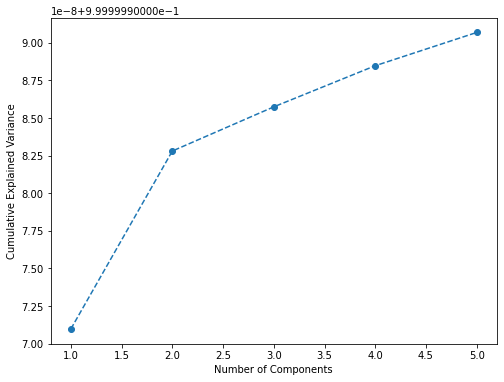

In [115]:
plt.figure(figsize=(8, 6))
plt.plot(range(1, 6), pca.explained_variance_ratio_.cumsum(), marker='o', linestyle='--')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')

# 7. K-Means Clustering<a id='kmeans'></a>

## 7-1. K-Means Algorithm with 2 Variables: purchase_count, avg_purchase_value

In [116]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans

In [117]:
X= x[['purchase_count','avg_purchase_value_eur' ]]

In [118]:
kmeans = KMeans(n_clusters = 3)
kmeans.fit(X)

In [119]:
kmeans.fit(X)

KMeans(n_clusters=3)

In [120]:
x['clusters']= kmeans.labels_

x['clusters'] = x['clusters'].astype(str)

In [130]:
# Different k parameters
kmeans4 = KMeans(n_clusters = 4)
kmeans4.fit(X)

KMeans(n_clusters=4)

In [132]:
x2 = x.copy()
x2['clusters']= kmeans4.labels_

x2['clusters'] = x2['clusters'].astype(str)


In [121]:

def add_cluster_label(x):
    if x == '0':
        return "Low Value, Low Frequency"
    elif x == '1':
        return "High Value, Low Frequency"
    else:
        return "Low Value, High Frequency"
    # Add elif statements....

#### Note: The above function is depending on the cluster outcome as the original label (0,1,2) is randomly assigned

In [122]:
x['cluster_label'] = x['clusters'].apply(add_cluster_label)

## 7-1-2. Show Cluster Results

In [123]:
# fig = px.scatter(x, x="avg_purchase_value_eur", y="purchase_count",color = 'clusters',
#                  color_discrete_sequence=px.colors.qualitative.Set2,
#              height=600, width=850, template = "plotly_white",
#              title = "<b> Clusters based on Avg.Purchase Value and Purchase Count<br>")
# fig.update_layout(title=dict(font=dict(size=21)),
#     xaxis_title="Avg. purchase Value", yaxis_title="Purchases", font=dict(
#         family="Avenir" ))
# fig.update_xaxes(ticks="outside",
#                  tickwidth=2,
#                  tickfont=dict(size=14))

# fig.show()

In [127]:
fig = px.scatter(x, x="avg_purchase_value_eur", y="purchase_count",color = 'cluster_label',
                 color_discrete_sequence=px.colors.qualitative.Set2,
             height=600, width=850, template = "plotly_white",
             title = "<b> Clusters based on Avg.Purchase Value and Purchase Count<br>")
fig.update_layout(title=dict(font=dict(size=21)),
    xaxis_title="Avg. purchase Value",
    yaxis_title="Purchases",
    font=dict(
        family="Avenir" ))
fig.update_xaxes(ticks="outside",
                 tickwidth=2,
                 tickfont=dict(size=14))

fig.show()

## 7-1-3. Explore Number of Cluster with Elbow Method

In [128]:
distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k)
    kmeanModel.fit(X)
    distortions.append(kmeanModel.inertia_)

In [129]:
fig = go.Figure(data=go.Scatter(x=[1,2,3,4,5,6,7,8,9,10], y=distortions))
fig.update_layout(title = "Ebow Method",height=400, width=800,
    xaxis_title="Number of Clusters (K)",yaxis_title="Distortion",font=dict(family="Avenir" ), template = "plotly_white")
fig.show()

## 7-2. K-Means Algorithm with 2 Variables:  median days between purchases, avg_purchase_value

In [129]:
# X_days = x[['median_days_between_purchases','avg_purchase_value_eur' ]]

# kmeans_days = KMeans(n_clusters = 3)
# kmeans_days.fit(X_days)

In [130]:
# x['clusters_days']= kmeans_days.labels_
# x['clusters_days'] = x['clusters_days'].astype(str)

In [131]:
# fig = px.scatter(x, x="avg_purchase_value_eur", y="median_days_between_purchases",color = 'clusters_days',
#                  color_discrete_sequence=px.colors.qualitative.Set2,
#              height=400, width=600, template = "plotly_white",
#              title = "<b> Clusters based on Avg.Value and Median Days between Orders<br>")
# fig.update_layout(title=dict(font=dict(size=16)),
#     xaxis_title="Avg. Purchase Value",
#     yaxis_title="Median Days between Purchases",
#     font=dict(
#         family="Avenir" ))
# fig.update_xaxes(ticks="outside",
#                  tickwidth=2,
#                  tickfont=dict(size=14))

# fig.show()

# 8. Evaluate and Validate Clusters<a id='evaluate'></a>

## 8-0. Silhouette Coefficient

In [131]:
from sklearn.metrics import silhouette_score
#Calculate Silhoutte Score
score = silhouette_score(X, kmeans.labels_, metric='euclidean')

# Print the score
print('Silhouetter Score: %.3f' % score)

Silhouetter Score: 0.471


In [133]:

#Calculate Silhoutte Score
score = silhouette_score(X, kmeans4.labels_, metric='euclidean')

# Print the score
print('Silhouetter Score: %.3f' % score)

Silhouetter Score: 0.401


## Improve by model by using different feature

In [140]:
X0= x[['avg_purchase_value_eur', 'median_days_between_purchases']]


In [141]:
kmeans0 = KMeans(n_clusters = 3)
kmeans0.fit(X0)

KMeans(n_clusters=3)

In [142]:
#Calculate Silhoutte Score
score0 = silhouette_score(X0, kmeans0.labels_, metric='euclidean')

# Print the score
print('Silhouetter Score: %.3f' % score0)


Silhouetter Score: 0.506


## 8-1. Join back the cluster label with the original df


In [109]:
cluster_labels = x[['user_id', 'clusters', 'cluster_label']]

In [110]:
dfa= df.merge(cluster_labels, how='left', on='user_id')

In [111]:
dfa.head()

,registration_date,registration_country,purchase_count,purchase_count_delivery,purchase_count_takeaway,first_purchase_day,last_purchase_day,user_id,breakfast_purchases,lunch_purchases,evening_purchases,dinner_purchases,late_night_purchases,total_purchases_eur,distinct_purchase_venue_count,min_purchase_value_eur,max_purchase_value_eur,avg_purchase_value_eur,preferred_device,ios_purchases,web_purchases,android_purchases,user_has_valid_payment_method,most_common_hour_of_the_day_to_purchase,most_common_weekday_to_purchase,avg_days_between_purchases,median_days_between_purchases,average_delivery_distance_kms,general_merchandise,grocery,pet_supplies,restaurant,retail_store,american,japanese,italian,middleeastern,mexican,indian,vietnamese,korean,nepalese,chinese,hawaiian,thai,greek,spanish,days_since_last_order,days_since_joined,days_to_first_order,customer_value,paid_customer,number_of_preferred_rest_type,clusters,cluster_label
0,2019-09-01,DNK,0,NaN,NaN,NaT,NaT,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ios,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,426,NaN,NaN,non-paid,0,NaN,NaN
1,2019-09-01,FIN,1,1.0,0.0,2020-09-02,2020-09-02,2,0.0,1.0,0.0,0.0,0.0,38.456,1.0,38.532,38.608,38.456,android,0.0,0.0,1.0,False,23.0,2.0,59.0,59.0,6.853,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,59.0,426,367.0,38.456,paid,0,1,"High Value, Low Frequency"
2,2019-09-01,DNK,19,19.0,0.0,2019-12-10,2020-05-25,3,0.0,4.0,1.0,14.0,0.0,631.488,9.0,20.280,43.688,33.396,android,0.0,19.0,0.0,True,21.0,2.0,9.0,3.0,6.559,1,9,0,9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,159.0,426,100.0,634.524,paid,0,NaN,NaN
3,2019-09-01,FIN,0,NaN,NaN,NaT,NaT,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,android,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,426,NaN,NaN,non-paid,0,NaN,NaN
4,2019-09-01,GRC,0,NaN,NaN,NaT,NaT,5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,android,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,426,NaN,NaN,non-paid,0,NaN,NaN


## 8-2. Mark non-paid customers in the clusters


In [112]:
# Mark non-paid customers in the clusters
dfa['cluster_label'] = np.where(dfa['purchase_count']== 0, 'non-paid', dfa['cluster_label'])

# For the rest un-classified users, label them as NaN
dfa['cluster_label']= dfa['cluster_label'].replace(np.nan, 'NaN')

dfa['cluster_label'] = np.where(dfa['cluster_label']== 'NaN', 'other', dfa['cluster_label'])

In [113]:
dfc = dfa[dfa['cluster_label'].isin(["High Value, Low Frequency", "Low Value, High Frequency","Low Value, Low Frequency"])]

## 8-3. Plot Boxplot for each numerical values

In [115]:
for i in num_values[:2]:

    fig = px.box(dfc, x="cluster_label", y=i, color = "cluster_label",title = f'<b>Boxplot by Clusters - {i} <br><sup>Clusters based on Purchase Count and Avg. Purchase Value</sup>',
                height=400, width=750, template = "plotly_white")
    fig.update_layout(title=dict(font=dict(size=16)),legend = dict(font = dict( size = 11)),
    xaxis_title="",yaxis_title=i, font=dict(family="Avenir"))
    fig.show()
    

In [117]:
# for i in num_values:

#     fig = px.box(dfa_days, x="clusters_days", y=i, color = "clusters_days",
#                  title = f'<b>Boxplot by Clusters - {i} <br><sup>Clusters based on Median Days Between Purchases and Avg. Purchase Value</sup>',
#                 height=400, width=750, template = "plotly_white")
#     fig.update_layout(
#     xaxis_title="",yaxis_title=i, font=dict(family="Avenir"))
#     fig.show()

In [118]:
fig = px.box(dfc, x="cluster_label", y='distinct_purchase_venue_count', color = "cluster_label",
             title = f'<b>Boxplot by Distinct Purchase Venue Count <br><sup>Clusters based on Purchase Count and Avg. Purchase Value</sup>',
                height=400, width=750, template = "plotly_white", color_discrete_sequence=px.colors.qualitative.Set2,)
fig.update_layout(title=dict(font=dict(size=16)),legend = dict(font = dict( size = 11)),
xaxis_title="",yaxis_title='Distinct Purchase Venue Count', font=dict(family="Avenir"))
fig.show()

In [119]:
fig = px.box(dfc, x="cluster_label", y='days_since_last_order', color = "cluster_label",
             title = f'<b>Boxplot by Days since Last Order <br><sup>Clusters based on Purchase Count and Avg. Purchase Value</sup>',
                height=400, width=750, template = "plotly_white", color_discrete_sequence=px.colors.qualitative.Set2,)
fig.update_layout(title=dict(font=dict(size=16)),legend = dict(font = dict( size = 11)),
xaxis_title="",yaxis_title='Days since last order', font=dict(family="Avenir"))
fig.show()

# 9. EDA with the generated Clusters<a id='eda_cluster'></a>

In [248]:
def plot_bar_chart_2_dim(df = df, col ='registration_country', stacked = False, y = 'user_id', color = '', title = ''):
    """Plot bar chart with Two dimensions"""
        
    fig = px.bar(df, x=col, y=y, height=460, width=800, template = "plotly_white",title = '<b>'+ title + '<br>',
                 color = color,
         color_discrete_sequence=px.colors.sequential.Mint)
    fig.update_layout(title=dict(font=dict(size=20)), legend = dict(font = dict( size = 13)),
        xaxis_title=col,
        yaxis_title=y,font=dict(family="Avenir" ))
    fig.update_xaxes(ticks="outside",type='category',
                     tickfont=dict(size=13))
    fig.show()

## 9-1. Create Recency Bins, Plot Bart chart with Clusters

In [187]:

def add_recency_label(x):
    if x <=30:
        return "0-30 Days"
    elif x > 30 and x <= 60:
        return "31-60 Days"
    elif x > 60 and x <= 90:
        return "61-90 Days"
    else:
        return ">90 Days"
    # Add elif statements....

In [188]:
dfc['recency_label'] = dfc['median_days_between_purchases'].apply(add_recency_label)

In [189]:
dfc.head()

,registration_date,registration_country,purchase_count,purchase_count_delivery,purchase_count_takeaway,first_purchase_day,last_purchase_day,user_id,breakfast_purchases,lunch_purchases,evening_purchases,dinner_purchases,late_night_purchases,total_purchases_eur,distinct_purchase_venue_count,min_purchase_value_eur,max_purchase_value_eur,avg_purchase_value_eur,preferred_device,ios_purchases,web_purchases,android_purchases,user_has_valid_payment_method,most_common_hour_of_the_day_to_purchase,most_common_weekday_to_purchase,avg_days_between_purchases,median_days_between_purchases,average_delivery_distance_kms,general_merchandise,grocery,pet_supplies,restaurant,retail_store,american,japanese,italian,middleeastern,mexican,indian,vietnamese,korean,nepalese,chinese,hawaiian,thai,greek,spanish,days_since_last_order,days_since_joined,days_to_first_order,customer_value,paid_customer,number_of_preferred_rest_type,clusters,cluster_label,recency_label
1,2019-09-01,FIN,1,1.0,0.0,2020-09-02,2020-09-02,2,0.0,1.0,0.0,0.0,0.0,38.456,1.0,38.532,38.608,38.456,android,0.0,0.0,1.0,False,23.0,2.0,59.0,59.0,6.853,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,59.0,426,367.0,38.456,paid,0,1,"High Value, Low Frequency",31-60 Days
12,2019-09-01,FIN,19,19.0,0.0,2020-04-18,2020-10-27,13,0.0,8.0,0.0,11.0,0.0,587.972,3.0,19.266,47.752,31.372,ios,19.0,0.0,0.0,True,7.0,3.0,11.0,9.0,3.303,1,9,0,9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4.0,426,230.0,596.068,paid,0,2,"Low Value, High Frequency",0-30 Days
13,2019-09-01,FIN,2,2.0,0.0,2020-08-21,2020-09-09,14,0.0,1.0,1.0,0.0,0.0,118.404,1.0,57.798,60.960,59.708,ios,0.0,0.0,2.0,False,5.0,6.0,19.0,19.0,1.382,0,0,0,2,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,52.0,426,355.0,119.416,paid,1,1,"High Value, Low Frequency",0-30 Days
15,2019-09-01,FIN,2,2.0,0.0,2020-05-18,2020-07-06,16,0.0,2.0,0.0,0.0,0.0,107.272,1.0,51.714,56.896,53.636,ios,2.0,0.0,0.0,False,0.0,1.0,49.0,49.0,4.619,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,117.0,426,260.0,107.272,paid,0,1,"High Value, Low Frequency",31-60 Days
16,2019-09-01,FIN,7,5.0,2.0,2019-12-05,2020-10-31,17,0.0,5.0,0.0,2.0,0.0,284.372,6.0,22.308,58.928,40.480,android,0.0,0.0,7.0,True,10.0,1.0,55.0,56.0,4.903,1,3,0,3,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,426,95.0,283.360,paid,1,1,"High Value, Low Frequency",31-60 Days


In [192]:
recency= aggregate_data(df = dfc, col= ['cluster_label', 'recency_label'], stacked = False, 
                         val = 'user_id', agg_method = 'count')

In [194]:
plot_bar_chart_2_dim(recency, col = 'cluster_label', color = 'recency_label', stacked = False, y = '# of Users',
                    title = '# of Users by Cluster and Recency Label')

In [197]:
days= aggregate_data(df = dfc, col= ['cluster_label'], stacked = False, 
                         val = 'median_days_between_purchases', agg_method = 'mean')

In [203]:
plot_bar_chart_2_dim(days, col = 'cluster_label', color = 'cluster_label', stacked = False, y = 'median_days_between_purchases',
                    title = 'Median Days between Purchases by Clusters')

## 9-2. Bar Chart for Numerical Values by segment

In [204]:
venue = aggregate_data(df = dfc, col= ['cluster_label'], stacked = False, 
                         val = 'distinct_purchase_venue_count', agg_method = 'mean')
plot_bar_chart_2_dim(venue, col = 'cluster_label', color = 'cluster_label', stacked = False, y = 'distinct_purchase_venue_count',
                    title = 'Avg. Distinct Purchase Venue Count by Cluster')

In [205]:
first_order = aggregate_data(df = dfc, col= ['cluster_label'], stacked = False, 
                         val = 'days_to_first_order', agg_method = 'mean')
plot_bar_chart_2_dim(first_order, col = 'cluster_label', color = 'cluster_label', stacked = False, y = 'days_to_first_order',
                    title = 'Avg. Days to First Order by Cluster')

In [207]:
plot_bar_chart_2_dim(venue, col = 'cluster_label', color = 'cluster_label', stacked = False, y = 'distinct_purchase_venue_count')

## 9-3. Country + Clusters

In [181]:
def aggregate_data(df = df, col= ['paid_customer', 'days bin'], stacked = False, val = 'user_id', agg_method = 'sum'):

    if agg_method =='mean':
        df_group =df.groupby(col)[val].mean().reset_index()
       
    elif agg_method =='count':
        if stacked == True:
            df_group = df.groupby(col)[val].size().transform(lambda x: x/x.sum()).reset_index().rename(columns={'user_id':'# of Users'})
        else:
            df_group =df.groupby(col)[val].size().reset_index().rename(columns={'user_id':'# of Users'})
            
    elif agg_method == 'sum':
        if stacked == True:
            df_group = df.groupby(col)[val].sum().groupby(level = 1).transform(lambda x: x/x.sum()).reset_index()
        else:
            df_group =df.groupby(col)[val].sum().reset_index()
    else:
        df_group =df.groupby(col)[val].sum().reset_index() #default agg method: sum
    return df_group

In [208]:
country = aggregate_data(df = dfc, col= ['cluster_label', 'registration_country'], stacked = True, 
                         val = 'purchase_count', agg_method = 'sum')
#country = aggregate_data_days(df = dfc, col= ['cluster_label', 'registration_country'], stacked = True, val = 'purchase_count')
plot_bar_chart_2_dim(df= country[country['registration_country'].isin(['FIN', 'DNK', 'GRC'])], col = 'registration_country', color = 'cluster_label', stacked = True, y = 'purchase_count')

## 9-4. Other Dimensions + Clusters

In [209]:
for c in cat_cols:
    grp = aggregate_data(df = dfc, col= ['cluster_label', c], stacked = True, 
                         val = 'purchase_count', agg_method = 'sum')
    #country = aggregate_data_days(df = dfc, col= ['cluster_label', 'registration_country'], stacked = True, val = 'purchase_count')
    plot_bar_chart_2_dim(df= grp, col = c, color = 'cluster_label', stacked = True, y = 'purchase_count')

## 9-5. Number of Users in each Cluster

In [262]:
n_users = aggregate_data(df = dfc, col= ['cluster_label'], stacked = True, 
                         val = 'user_id', agg_method = 'count')
total_value = aggregate_data(df = dfc, col= ['cluster_label'], stacked = False, 
                         val = 'total_purchases_eur', agg_method = 'sum')

In [276]:
def plot_pie_chart_2_dim(df = df, col ='registration_country', stacked = False, y = 'user_id', color = '', title = ''):
    """Plot bar chart with Two dimensions"""
        
    fig = px.pie(df, names=col, values=y, height=450, width=750, template = "plotly_white",title = '<b>'+ title + '<br>',
                 color = color,color_discrete_sequence=px.colors.sequential.Mint)
    fig.update_traces(textfont_size=16)
    fig.update_layout(title=dict(font=dict(size=20)), legend = dict(font = dict( size = 13)),
        xaxis_title=col,xaxis={'categoryorder':'total descending'},
        yaxis_title=y,font=dict(family="Avenir" ))
    fig.show()

In [278]:
plot_pie_chart_2_dim(df= n_users, col = 'cluster_label', color = 'cluster_label', stacked = True, y = '# of Users',
                    title = '<b>% of Users for each cluster <br>')

In [280]:
plot_pie_chart_2_dim(df= total_value, col = 'cluster_label', color = 'cluster_label', stacked = True, y = 'total_purchases_eur',
                    title = '<b> % of Total Purchases value (EUR) by Cluster <br>')

## 9-6. Time Heatmap

In [124]:
test_df = dfc[dfc['cluster_label']=='Low Value, High Frequency']
test_time = test_df.groupby(['most_common_hour_of_the_day_to_purchase','most_common_weekday_to_purchase'])['user_id'].size().reset_index().rename(columns={'user_id':'# of Users'})

In [125]:
time_df = pd.pivot(test_time , index='most_common_weekday_to_purchase', columns='most_common_hour_of_the_day_to_purchase', values='# of Users')

In [222]:
# fig = px.imshow(time_df, color_continuous_scale='RdBu_r', title = '# of High Value, Low Frequency Users <br>by Day of Week and Time of Day')
# # fig.update_xaxes(categoryorder='array', categoryarray= ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])
# # fig.update_yaxes(categoryorder='array', categoryarray= ['morning', 'noon', 'afternoon', 'evening', 'night', 'midnight'])
# fig.update_layout(legend_title_text='Percentage Diff',title=dict(font=dict(size=25)),
#         xaxis_title="Time of Day",
#         yaxis_title='Day of Week',
#         font=dict(
#             family="Avenir", size = 10 ))

# fig.show()

In [223]:
# fig = px.imshow(time_df, color_continuous_scale='RdBu_r', title = '# of Low Value, High Frequency Users <br>by Day of Week and Time of Day')
# # fig.update_xaxes(categoryorder='array', categoryarray= ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])
# # fig.update_yaxes(categoryorder='array', categoryarray= ['morning', 'noon', 'afternoon', 'evening', 'night', 'midnight'])
# fig.update_layout(legend_title_text='Percentage Diff',title=dict(font=dict(size=25)),
#         xaxis_title="Time of Day",
#         yaxis_title='Day of Week',
#         font=dict(
#             family="Avenir", size = 10 ))

# fig.show()

## 9-7. Aggregation by Meal type, Restaurant Type, and Device, and Store Type, 

In [210]:
def plot_bar_chart_2_dim_colorful(df = df, col ='registration_country', stacked = False, y = 'user_id', color = '', title = ''):
    """Plot bar chart with Two dimensions"""
        
    fig = px.bar(df, x=col, y=y, height=380, width=750, template = "plotly_white",title = '<b>'+ title + '<br>',
                 color = color,
         color_discrete_sequence=px.colors.qualitative.Set1)
    fig.update_layout(title=dict(font=dict(size=18)), legend = dict(font = dict( size = 13)),
        xaxis_title=col,
        yaxis_title=y,font=dict(family="Avenir" ))
    fig.update_xaxes(ticks="outside",type='category',
                     tickfont=dict(size=12))
    fig.show()

In [211]:
def Aggregate_column_data(df = dfc, by =['cluster_label'], cols = ['breakfast_purchases','lunch_purchases', 
                                            'evening_purchases', 'dinner_purchases',
                                            'late_night_purchases' ], stacked = False, groupby_col = 'time',
                         agg_method = 'sum', val = 'purchase_count'):
    dfs = []
    for i in cols:
        print(i, groupby_col)
        subset = df.groupby(by)[i].sum().reset_index().rename(columns = {i:'purchases'})
        subset[groupby_col]= i[:-10]
        dfs.append(subset)
            
    df_all = pd.concat(dfs)
    
    if stacked == True:
        df_stacked = df_all.groupby(by+[groupby_col])['purchases'].sum().rename('purchases').groupby(level = 0).transform(lambda x: x/x.sum()).reset_index()
        return df_stacked
    else:
        return df_all
    return df_all

### 9-7-1. Aggregate by Meal time

In [212]:
meal = Aggregate_column_data(df = dfc, by =['cluster_label'], cols = ['breakfast_purchases','lunch_purchases', 
                                            'evening_purchases', 'dinner_purchases',
                                            'late_night_purchases' ], stacked = True, groupby_col = 'time',
                         agg_method = 'sum', val = 'purchase_count')
plot_bar_chart_2_dim_colorful(meal, col = 'cluster_label', color = 'time', stacked = False, y = 'purchases',
                    title = '# of Purchase by Meal Time')

breakfast_purchases time
lunch_purchases time
evening_purchases time
dinner_purchases time
late_night_purchases time


In [213]:
plot_bar_chart_2_dim_colorful(meal, col = 'cluster_label', color = 'time', stacked = False, y = 'purchases',
                    title = '# of Purchase by Meal Time')

### 9-7-2. Aggregate by Store Type

In [214]:
def Aggregate_column_data(df = dfc, by =['cluster_label'], cols = ['breakfast_purchases','lunch_purchases', 
                                            'evening_purchases', 'dinner_purchases',
                                            'late_night_purchases' ], stacked = False, groupby_col = 'time',
                         agg_method = 'sum', val = 'purchase_count'):
    dfs = []
    for i in cols:
        print(i, groupby_col)
        subset = df.groupby(by)[i].sum().reset_index().rename(columns = {i:'purchases'})
        subset[groupby_col]= i
        dfs.append(subset)
            
    df_all = pd.concat(dfs)
    
    if stacked == True:
        df_stacked = df_all.groupby(by+[groupby_col])['purchases'].sum().rename('purchases').groupby(level = 0).transform(lambda x: x/x.sum()).reset_index()
        return df_stacked
    else:
        return df_all
    return df_all

In [215]:
store = Aggregate_column_data(df = dfc, by =['cluster_label'], cols = store_type_list, stacked = True, 
                              groupby_col = 'store_type',
                         agg_method = 'sum', val = 'purchase_count')

general_merchandise store_type
grocery store_type
pet_supplies store_type
restaurant store_type
retail_store store_type


In [216]:
plot_bar_chart_2_dim(store, col = 'cluster_label', color = 'store_type', stacked = False, y = 'purchases')

In [217]:
restaurant = Aggregate_column_data(df = dfc, by =['cluster_label'], cols = restaurant_types_list, stacked = True, groupby_col = 'restaurant_type',
                         agg_method = 'sum', val = 'purchase_count')
plot_bar_chart_2_dim(restaurant, col = 'cluster_label', color = 'restaurant_type', stacked = False, y = 'purchases')

american restaurant_type
japanese restaurant_type
italian restaurant_type
middleeastern restaurant_type
mexican restaurant_type
indian restaurant_type
vietnamese restaurant_type
korean restaurant_type
nepalese restaurant_type
chinese restaurant_type
hawaiian restaurant_type
thai restaurant_type
greek restaurant_type
spanish restaurant_type


### 9-7-3. Devices

In [218]:
device = Aggregate_column_data(df = dfc, by =['cluster_label'], cols = ['ios_purchases','web_purchases', 'android_purchases' ], stacked = True, groupby_col = 'restaurant_type',
                         agg_method = 'sum', val = 'purchase_count')
plot_bar_chart_2_dim(device, col = 'cluster_label', color = 'restaurant_type', stacked = False, y = 'purchases')

ios_purchases restaurant_type
web_purchases restaurant_type
android_purchases restaurant_type


### 9-7-4. Deliver/takeaway

In [219]:
tk = Aggregate_column_data(df = dfc, by =['cluster_label'], cols = ['purchase_count_delivery','purchase_count_takeaway'], stacked = True, groupby_col = 'meal_type',
                         agg_method = 'sum', val = 'purchase_count')
plot_bar_chart_2_dim(tk, col = 'cluster_label', color = 'meal_type', stacked = False, y = 'purchases')

purchase_count_delivery meal_type
purchase_count_takeaway meal_type


## 9-8. Non-paid Customers

In [ ]:
dfc['days_since_joined'].mean()

In [239]:
dfnp = dfa[dfa['cluster_label'].isin(['paid', 'non-paid'])]

In [251]:
dfnp_plot = aggregate_data(df = dfa, col= ['paid_customer', 'user_has_valid_payment_method'], stacked = True, 
                         val = 'user_id', agg_method = 'count')
#country = aggregate_data_days(df = dfc, col= ['cluster_label', 'registration_country'], stacked = True, val = 'purchase_count')
plot_bar_chart_2_dim(df= dfnp_plot , col = 'paid_customer', color = 'user_has_valid_payment_method', stacked = False, 
                     y = '# of Users', title = '# of Users by Valid Payment Method and Paid/Non-Paid')